In [18]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor, export_text
from ydata_profiling import ProfileReport

pd.set_option("display.max_columns", None)
pd.set_option("display.max_rows", None)

In [33]:
df = pd.read_pickle("all_tweets_v12.pkl")
df.head(3)

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4,fear,anger,anticip,trust,surprise,positive,negative,sadness,disgust,joy,anticipation,translated_tweet,age_of_account_in_days_author_when_tweeted,posted_during_an_important_event
0,1449804331142811655,[],1617597872803041280,2023-01-23 18:59:21,[1617597872803041280],1617597872803041280,NaN,tr,False,NaN,everyone,"Kararlarındaki temel dayanak, hukukun evrensel...",Goksun_KHK,NaN,NaN,0,2,1,0,82,NaN,NaN,"[{'start': 95, 'end': 120, 'tag': 'OhalKomisyo...",NaN,NaN,NaN,NaN,0,ORG,NOT AVAILABLE,OhalKomisyonuHukuksuzdur,OhalKomisyonuHukuksuzdur,1,120,0,1,0,0,standard,0.012195,0.024390,tr,0.874858,0.847463,0.13,0.51,0.22,0.91,0.91,0.08,0.25,0.12,0.44,0.1,0.87,0.87,0.19,0.16,False,1107.0,174.0,2962.0,470.0,0.994189,0,1,68361,0.013817,0.435233,1.231915,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,search for justice,False,2023,0.976296,0.216440,0.0,1,0,0,NaN,NaN,NaN,NaN,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,The basic basis in their decisions is the demo...,463.0,False
1,1449804331142811655,[],1617597646339702823,2023-01-23 18:58:27,[1617597646339702823],1617597646339702823,NaN,fr,False,NaN,everyone,#OhalKomisyonuHukuksuzdur https://t.co/3aUr5MZWPU,Goksun_KHK,NaN,NaN,0,1,0,0,52,[3_1617597636604723228],NaN,"[{'start': 0, 'end': 25, 'tag': 'OhalKomisyonu...","[{'start': 26, 'end': 49, 'url': 'https://t.co...",NaN,NaN,NaN,0,ORG,NOT AVAILABLE,OhalKomisyonuHukuksuzdur,OhalKomisyonuHukuksuzdur,1,49,1,1,0,0,standard,0.000000,0.019231,tr,0.874858,0.847463,0.13,0.51,0.22,0.91,0.91,0.08,0.25,0.12,0.44,0.1,0.87,0.87,0.19,0.16,False,1107.0,174.0,2962.0,470.0,0.733746,0,1,68307,0.013817,0.435233,1.231915,3_1617597636604723228,photo,1600.0,https://pbs.twimg.com/media/FnLceudWABwBC4b.jpg,1600.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fr,False,2023,-0.537300,-0.843391,1.0,1,1,0,2560000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,463.0,False
2,1449804331142811655,[],1617597571903676417,2023-01-23 18

In [34]:
df.tweet_type.unique()

array(['standard', 'retweeted', 'replied_to', 'quoted'], dtype=object)

In [35]:
df = df[df.tweet_type == "standard"]
df.shape

(91102, 133)

In [36]:
import numpy as np
import pandas as pd


# define a function to detect outliers using the z-score method
def detect_outliers_zscore(df, col1, col2, threshold=3):
    """
    Detect outliers in a pandas dataframe based on two columns using the z-score method.
    """
    z_scores = np.abs((df[col1] - df[col1].mean()) / df[col1].std()) + np.abs(
        (df[col2] - df[col2].mean()) / df[col2].std()
    )
    return df[z_scores > threshold]

n_outliers = 0
for author in df.author.unique():
    df_author = df[df.author == author]
    outliers = detect_outliers_zscore(df_author, "like_count", "retweet_count")
    n_outliers += outliers.shape[0]
print(n_outliers, df.shape[0], n_outliers / df.shape[0])

4203 91102 0.04613510131500955


In [37]:
def detect_outliers_tukey(df, col1, col2):
    """
    Detect outliers in a pandas dataframe based on two columns using Tukey's method.
    """
    q1 = df[[col1, col2]].quantile(0.25)
    q3 = df[[col1, col2]].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    return df[
        (df[col1] < lower_bound[col1])
        | (df[col1] > upper_bound[col1])
        | (df[col2] < lower_bound[col2])
        | (df[col2] > upper_bound[col2])
    ]

n_outliers = 0
for author in df.author.unique():
    df_author = df[df.author == author]
    outliers = detect_outliers_tukey(df_author, "like_count", "retweet_count")
    n_outliers += outliers.shape[0]
print(n_outliers, df.shape[0], n_outliers / df.shape[0])

9858 91102 0.10820838181379114


In [6]:
df.text.value_counts()

@istanbul_KHK: Mücadele umutlarımızı büyütür\nMücadele özgürleştirir\nMücadele yaşatır\nBize omuz veren tüm dostlarımıza sonsuz  teşekkürle…                    77
@pediat_surgeon: Ey insanlar bizi bizden kendi sesimizden duyun, \nBize bir kulak verin artık. \nHukuksuzluklara destek vermeyin artık.…                        60
@ilkadim55_KHK: Suça karışmış hiç bir KHK’lı gördünüz mü\n#KHKlıHerYerde                                                                                        52
@ilkadim55_KHK: Nokta kadar menfaat İçin virgül kadar eğilmedik \n#KHKlıHerYerde                                                                                51
@gergerliogluof: Biliyor musunuz?\n30 yaşındaki Nesrin Gençosman'ın, Ordu Cezaevinde ilaçları verilmediği için hayatını kaybettiği iddias…                      45
@ilkadim55_KHK: Adalet Terazisi doğru tartmalı\nHukukta ÇifteStandart                                                                                           45
@PASADAYI_: TAGA DESTE

In [5]:
df.shape

(182648, 133)

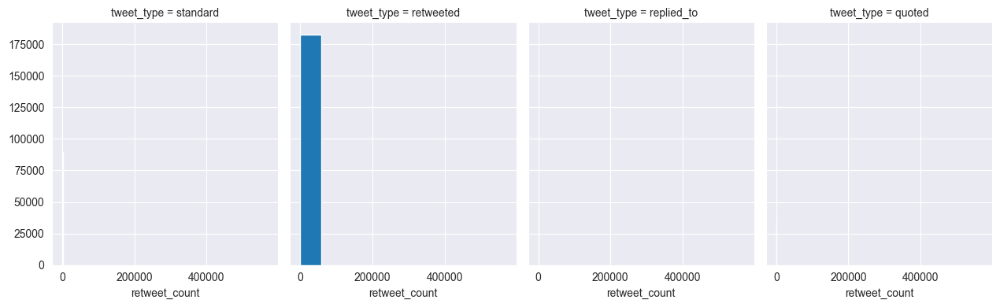

In [3]:
# set the Seaborn style to "darkgrid"
sns.set_style("darkgrid")

# create a FacetGrid to plot histograms for each tweet_type
g = sns.FacetGrid(df, col="tweet_type", height=4, aspect=0.8)

# plot a histogram of like_count for each tweet_type
g.map(plt.hist, "retweet_count", bins=10)

# show the plots
plt.show()

In [4]:
df.groupby(["tweet_type"])["like_count", "retweet_count"].describe()

/var/folders/z5/hjyvlbm54v1cpt9s019vbv9w0000gn/T/ipykernel_1474/133297248.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df.groupby(["tweet_type"])["like_count", "retweet_count"].describe()


like_count                                                          \
                count        mean          std  min  25%   50%   75%      max   
tweet_type                                                                      
quoted        36571.0   47.314949   294.929634  0.0  1.0   4.0  16.0  28509.0   
replied_to    48715.0   23.100893   272.202859  0.0  1.0   2.0   5.0  25753.0   
retweeted    182648.0    0.000000     0.000000  0.0  0.0   0.0   0.0      0.0   
standard      91102.0  220.721642  1330.305159  0.0  5.0  16.0  61.0  73017.0   

           retweet_count                                                 \
                   count        mean          std  min  25%   50%   75%   
tweet_type                                                                
quoted           36571.0   10.276886    53.496979  0.0  0.0   1.0   5.0   
replied_to       48715.0    4.330042    33.192648  0.0  0.0   0.0   1.0   
retweeted       182648.0  248.566456  2434.066974  0.0  7.0  23.0  96.0   
standard         91102.0   50.116166   203.240353  0.0  2.0   6.0  19.0   

                      
                 max  
tweet_type            
quoted        3084.0  
replied_to    2321.0  
retweeted   570083.0  
standard      7413.0

# Investigate Retweets

In [9]:
df[df.tweet_type == "retweeted"].head(5)

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4
2,1449804331142811655,[],1617597571903676417,2023-01-23 18:58:09,[1617597571903676417],1617597571903676417,NaN,en,False,[<ReferencedTweet id=1617584897383714816 type=...,everyone,@Yozgat_KHK: #OhalKomisyonuHukuksuzdur\nÇünkü ...,Goksun_KHK,NaN,NaN,0,48,0,0,0,NaN,NaN,"[{'start': 16, 'end': 41, 'tag': 'OhalKomisyon...",NaN,"[{'start': 3, 'end': 14, 'username': 'Yozgat_K...",NaN,NaN,1,ORG,NOT AVAILABLE,OhalKomisyonuHukuksuzdur,OhalKomisyonuHukuksuzdur,1,99,0,1,1,0,retweeted,NaN,inf,tr,0.874858,0.847463,0.13,0.51,0.22,0.91,0.91,0.08,0.25,0.12,0.44,0.1,0.87,0.87,0.19,0.16,False,1107.0,174.0,2962.0,470.0,0.000000,0,1,68289,0.013817,0.435233,1.231915,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,en,False,2023,0.675590,-0.737277,0.0,1,0,1,NaN,NaN,NaN,NaN
4,1449804331142811655,[],1617597477963829248,2023-01-23 18:57:46,[1617597477963829248],1617597477963829248,NaN,tr,False,[<ReferencedTweet id=1617597368417013761 type=...,everyone,@Malatya_KHK: Öldükten sonra insanlari işe iad...,Goksun_KHK,NaN,NaN,0,4,0,0,0,NaN,NaN,"[{'start': 57, 'end': 82, 'tag': 'OhalKomisyon...",NaN,"[{'start': 3, 'end': 15, 'username': 'Malatya_...",NaN,NaN,1,ORG,NOT AVAILABLE,OhalKomisyonuHukuksuzdur,OhalKomisyonuHukuksuzdur,1,82,0,1,1,0,retweeted,NaN,inf,tr,0.874858,0.847463,0.13,0.51,0.22,0.91,0.91,0.08,0.25,0.12,0.44,0.1,0.87,0.87,0.19,0.16,False,1107.0,174.0,2962.0,470.0,0.900369,0,1,68266,0.013817,0.435233,1.231915,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,dismissal of governmental workers,False,2023,0.664796,0.747025,0.0,1,0,1,NaN,NaN,NaN,NaN
7,1449804331142811655,[],1617597218038349833,2023-01-23 18:56:44,[1617597218038349833],1617597218038349833,NaN,tr,False,[<ReferencedTweet id=1617592668011233290 type=...,everyone,@Dbakir_KHK_21: Talimat ile kuruldu\ntalimat i...,Goksun_KHK,NaN,NaN,0,25,0,0,0,NaN,NaN,"[{'start': 93, 'end': 118, 'tag': 'OhalKomisyo...",NaN,"[{'start': 3, 'end': 17, 'username': 'Dbak

In [10]:
retweets = df[df.tweet_type == "retweeted"]
retweets["duplicated_retweets"] = df.text.duplicated()

/var/folders/z5/hjyvlbm54v1cpt9s019vbv9w0000gn/T/ipykernel_43579/1798127718.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  retweets["duplicated_retweets"] = df.text.duplicated()


In [11]:
duplicated_retweets = retweets[retweets.duplicated_retweets]

In [12]:
duplicated_retweets.sort_values("text").iloc[2200].text

'@Ankara_KHK: Dostoyevski şöyle diyor;\nHiç İnsan Öldürmediği halde\nBir katilden daha cani\nİnsanlar gördüm\nUmudumuzu Öldürenleri\nGördüm..💙…'

In [13]:
df[
    df.text.str.contains(
        "Dostoyevski şöyle diyor;\nHiç İnsan Öldürmediği halde\nBir katilden daha cani"
    )
]

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4
155911,1480235753561075715,"[{'domain': {'id': '131', 'name': 'Unified Twi...",1517225271732097027,2022-04-21 19:34:28,[1517225271732097027],1517225271732097027,NaN,tr,False,[<ReferencedTweet id=1517207035267350528 type=...,everyone,@Ankara_KHK: Dostoyevski şöyle diyor;\nHiç İns...,Kirsehir_KHK,NaN,NaN,0,21,0,0,0,NaN,NaN,NaN,NaN,"[{'start': 3, 'end': 14, 'username': 'Ankara_K...",NaN,NaN,1,ORG,NOT AVAILABLE,NaN,NaN,0,140,0,0,1,0,retweeted,NaN,inf,tr,0.845754,0.806896,0.14,0.49,0.02,0.87,0.87,0.59,0.07,0.16,0.45,0.03,0.71,0.71,0.48,0.08,False,1463.0,708.0,4041.0,386.0,0.996947,3,4,70468,0.460627,0.334886,6.119171,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,expressing wishes,False,2022,-0.597159,-0.802123,NaN,0,0,1,NaN,NaN,NaN,NaN
289530,1485178621006422023,"[{'domain': {'id': '131', 'name': 'Unified Twi...",1517212996820520960,2022-04-21 18:45:41,[1517212996820520960],1517212996820520960,NaN,tr,False,[<ReferencedTweet id=1517207035267350528 type=...,everyone,@Ankara_KHK: Dostoyevski şöyle diyor;\nHiç İns...,havza_khk,NaN,NaN,0,21,0,0,0,NaN,NaN,NaN,NaN,"[{'start': 3, 'end': 14, 'username': 'Ankara_K...",NaN,NaN,1,ORG,NOT AVAILABLE,NaN,NaN,0,140,0,0,1,0,retweeted,NaN,inf,tr,0.852405,0.805275,0.19,0.47,0.20,0.88,0.88,0.16,0.07,0.18,0.31,0.10,0.59,0.59,0.01,0.03,False,1510.0,898.0,23319.0,372.0,0.996947,3,4,67541,0.006508,0.348970,9.913978,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,expressing wishes,False,2022,-0.987229,-0.159307,NaN,0,0,1,NaN,NaN,NaN,NaN


In [14]:
ankara_tweets = df[df.author == "Ankara_KHK"]
ankara_tweets[ankara_tweets.text.str.contains("Bu akşam çok önemli bir tag var")]

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4


In [15]:
df[df.id == 1517207035267350528]

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4


In [16]:
pattern = r"id=([^\s>]+) type"
referenced_tweet_ids = df.referenced_tweets.str.extract(pattern)[0]
referenced_tweet_ids = referenced_tweet_ids[~referenced_tweet_ids.isna()].to_list()
referenced_tweet_ids = list(map(int, referenced_tweet_ids))
referenced_tweet_ids[:4]

[1617584897383714816,
 1617597368417013761,
 1617592668011233290,
 1617588066889121792]

In [17]:
all_tweet_ids = df.id.to_list()
k = 0
for i in set(all_tweet_ids).intersection(referenced_tweet_ids):
    print(i)
    k += 1
    if k > 4:
        break

1604900308034912256
1551482618557890560
1547263683587342338
1616142350572453891
1528809358888402948


In [18]:
df["referenced_tweet_id"] = df.referenced_tweets.str.extract(pattern)[0]

In [19]:
df[df.id == 1604900308034912256]

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4,referenced_tweet_id
106749,870209307983433728,[],1604900308034912256,2022-12-19 18:03:45,[1604900308034912256],1604900308034912256,NaN,tr,False,NaN,everyone,Bizler hukuk dışında hiç bir şey talep etmiyor...,KHK_Akademi,NaN,NaN,2,29,79,1,3644,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,ORG,NOT AVAILABLE,NaN,NaN,0,69,0,0,0,0,standalone,0.021679,0.007958,tr,0.807604,0.794711,0.33,0.32,0.1,0.78,0.78,0.0,0.01,0.4,0.33,0.02,0.52,0.33,0.0,0.0,False,6156.0,4243.0,12459.0,2069.0,0.715606,0,12,65025,0.079493,0.789171,0.419526,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,decree-law,False,2022,-0.608761,-0.793353,NaN,0,0,0,NaN,NaN,NaN,NaN,NaN


In [20]:
df[df.referenced_tweet_id == "1604900308034912256"]

,author_id,context_annotations,conversation_id,created_at,edit_history_tweet_ids,id,in_reply_to_user_id,lang,possibly_sensitive,referenced_tweets,reply_settings,text,author,withheld,geo,quote_count,retweet_count,like_count,reply_count,impression_count,media_keys,poll_ids,hashtags,urls,mentions,cashtags,annotations,is_retweet,gender_of_author,profession_of_author,hashtags_flattened,trend_topics,n_trend_topics,text_length,has_media,has_hashtags,has_mentions,is_reply,tweet_type,ratio_like,ratio_retweet,majority_lang,english,universal,eng_astroturf,eng_fake_follower,eng_financial,eng_other,eng_overall,eng_self_declared,eng_spammer,uni_astroturf,uni_fake_follower,uni_financial,uni_other,uni_overall,uni_self_declared,uni_spammer,verified_author,followers_count_author,following_count_author,tweet_count_author,age_of_account_in_days_author,sentiment,created_at_day_of_week,created_at_month_of_year,created_at_time_of_day_in_seconds,reply_to_tweet_ratio,retweet_to_tweet_ratio,average_tweets_of_author_per_day,media_media_key_1,media_type_1,media_height_1,media_url_1,media_width_1,media_public_metrics_1,media_preview_image_url_1,media_duration_ms_1,media_alt_text_1,media_media_key_2,media_type_2,media_height_2,media_url_2,media_width_2,media_public_metrics_2,media_preview_image_url_2,media_duration_ms_2,media_alt_text_2,media_media_key_3,media_type_3,media_height_3,media_url_3,media_width_3,media_public_metrics_3,media_preview_image_url_3,media_duration_ms_3,media_alt_text_3,media_media_key_4,media_type_4,media_height_4,media_url_4,media_width_4,media_public_metrics_4,media_preview_image_url_4,media_duration_ms_4,media_alt_text_4,sttm_topic,political_context_annotation,created_at_year,created_at_time_of_day_in_seconds_sin,created_at_time_of_day_in_seconds_cos,n_media_keys,n_hashtags,n_urls,n_mentions,media_resolution_1,media_resolution_2,media_resolution_3,media_resolution_4,referenced_tweet_id
68,1449804331142811655,[],1604900387940667402,2022-12-19 18:04:04,[1604900387940667402],1604900387940667402,NaN,tr,False,[<ReferencedTweet id=1604900308034912256 type=...,everyone,@KHK_Akademi: Bizler hukuk dışında hiç bir şey...,Goksun_KHK,NaN,NaN,0,29,0,0,0,NaN,NaN,NaN,NaN,"[{'start': 3, 'end': 15, 'username': 'KHK_Akad...",NaN,NaN,1,ORG,NOT AVAILABLE,NaN,NaN,0,86,0,0,1,0,retweeted,NaN,inf,tr,0.874858,0.847463,0.13,0.51,0.22,0.91,0.91,0.08,0.25,0.12,0.44,0.10,0.87,0.87,0.19,0.16,False,1107.0,174.0,2962.0,470.0,0.916507,0,12,65044,0.013817,0.435233,1.231915,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,decree-law,False,2022,-0.893633,0.448799,NaN,0,0,1,NaN,NaN,NaN,NaN,1604900308034912256
68347,1437697452870623235,[],1604921696552714251,2022-12-19 19:28:45,[1604921696552714251],1604921696552714251,NaN,tr,False,[<ReferencedTweet id=1604900308034912256 type=...,everyone,@KHK_Akademi: Bizler hukuk dışında hiç bir şey...,Burdur_KHK,NaN,NaN,0,29,0,0,0,NaN,NaN,NaN,NaN,"[{'start': 3, 'end': 15, 'username': 'KHK_Akad...",NaN,NaN,1,ORG,NOT AVAILABLE,NaN,NaN,0,86,0,0,1,0,retweeted,NaN,inf,tr,0.800880,0.799570,0.18,0.31,0.04,0.74,0.74,0.00,0.04,0.12,0.17,0.02,0.56,0.36,0.00,0.05,False,1054.0,162.0,1471.0,503.0,0.916507,0,12,70125,0.071429,0.804582,1.475149,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,decree-law,False,2022,-0.737277,-0.675590,NaN,0,0,1,NaN,NaN,NaN,NaN,1604900308034912256
127435,1434476082447671384,[],1604900308034912256,2022-12-19 19:16:35,[1604918636333989903],1604918636333989903,8.702093e+17,tr,False,[<ReferencedTweet id=1604900308034912256 type=...,everyone,@KHK_Akademi KHKlıHukuk İstiyor \nUluslararası...,Mus_KHK,NaN,NaN,0,0,0,0,5,NaN,NaN,NaN,NaN,"[{'start': 0, 'end': 12, 'username': 'KHK_Akad...",NaN,NaN,0,ORG,NOT AVAILABLE,NaN,NaN,0,73,0,0,1,1,replied_to,0.0,0.0,tr,0.833918,0.767421,0.14,0.35,0.01,0.85,0.85,0.07,0.04,0.10,0.22,0.00,0.53,0.26,0.0

# Investigate Quotes

In [21]:
quotes = df[df.tweet_type == "quoted"]

In [22]:
relevant_columns = [
    "created_at",
    "in_reply_to_user_id",
    "lang",
    "possibly_sensitive",
    "reply_settings",
    "author",
    "withheld",
    "geo",
    "quote_count",
    "retweet_count",
    "like_count",
    "reply_count",
    "impression_count",
    "media_keys",
    "poll_ids",
    "hashtags",
    "urls",
    "mentions",
    "cashtags",
    "annotations",
    "is_retweet",
]

In [23]:
profile = ProfileReport(quotes[relevant_columns], title="Profiling Report")
profile.to_widgets()
profile.to_notebook_iframe()

/Users/hasansalimkanmaz/environments/kuleuven-thesis/lib/python3.10/site-packages/ydata_profiling/utils/dataframe.py:137: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.rename(columns={"index": "df_index"}, inplace=True)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# standard tweets

In [5]:
standard_tweets = df[df.tweet_type == "standard"]

<AxesSubplot: >

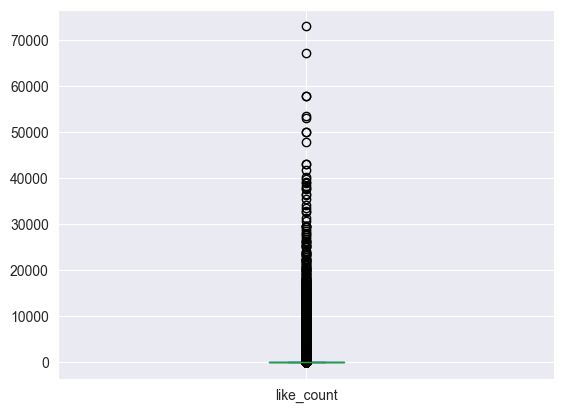

In [9]:
standard_tweets.like_count.plot.box()

<AxesSubplot: >

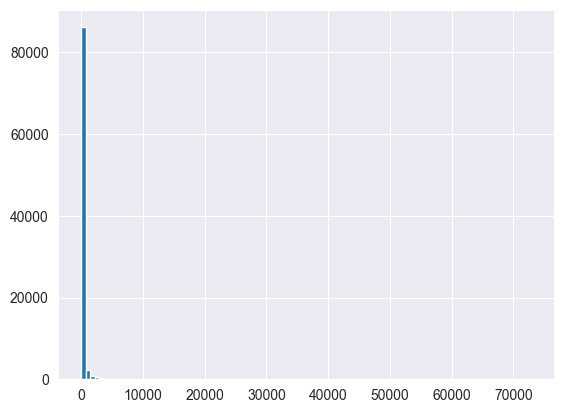

In [14]:
standard_tweets.like_count.hist(bins=100)